# Trigger Word Detection with Gated Recurrent Unit (GRU)
 
We will construct a speech dataset and implement an algorithm for trigger word detection (sometimes also called keyword detection, or wakeword detection). Trigger word detection is the technology that allows devices like Amazon Alexa, Google Home, Apple Siri, and Baidu DuerOS to wake up upon hearing a certain word.  

For this project, our trigger word will be "Activate." Every time it hears us say "activate," it will make a "chiming" sound. By the end of this notebook, we will be able to record a clip of ourselves talking, and have the algorithm trigger a chime when it detects us saying "activate." 

<img src="images/sound.png" style="width:1000px;height:150px;">

We will discuss spectrogram, which is the input of our RNN.

The training data can be synthesized using the audio clips of activates, negatives, and backgrounds, while the development data should be real.

Our model consists of 1-D convolutional layers, GRU layers, and dense layers.

Once we've estimated the probability of having detected the word "activate" at each output step, we can trigger a "chiming" sound to play when the probability is above a certain threshold. 

In [1]:
%matplotlib inline
from tensorflow.python.util import deprecation
deprecation._PRINT_DEPRECATION_WARNINGS = False
import tensorflow as tf
tf.compat.v1.logging.set_verbosity(tf.compat.v1.logging.ERROR)
import numpy as np
import matplotlib.pyplot as plt
import IPython
from scipy.io import wavfile
from pydub import AudioSegment
from pydub.playback import play # can be used to play audio
import os
import pydot
from IPython.display import SVG
from keras.utils.vis_utils import model_to_dot
from keras.layers import Input, Conv1D, BatchNormalization, Activation, Dropout, GRU, TimeDistributed, Dense
from keras.models import Model, load_model
from keras.optimizers import Adam

D:\Python\Anaconda3\envs\py3\lib\site-packages\pydub\utils.py:165: RuntimeWarning: Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work
  warn("Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work", RuntimeWarning)
D:\Python\Anaconda3\envs\py3\lib\site-packages\pydub\utils.py:179: RuntimeWarning: Couldn't find ffplay or avplay - defaulting to ffplay, but may not work
  warn("Couldn't find ffplay or avplay - defaulting to ffplay, but may not work", RuntimeWarning)
Using TensorFlow backend.


In [2]:
Tx = 5511 # number of time steps input to the model from the spectrogram
Ty = 1375 # number of time steps in the output of the model
n_freq = 101 # number of frequencies input to the model at each time step of the spectrogram

## 1. Data Synthesis: Creating a Speech Dataset 

We start by building a dataset for our trigger word detection algorithm. A speech dataset should ideally be as close as possible to the application we will want to run it on. In this case, we'd like to detect the word "activate" in working environments (library, home, offices, open-spaces ...). We thus need to create recordings with a mix of positive words ("activate") and negative words (random words other than activate) on different background sounds. 

### 1.1 Raw Data   

Suppose we've gone to libraries, cafes, restaurants, homes and offices all around the region to record background noises, as well as snippets of audio of people saying positive/negative words. This dataset includes people speaking in a variety of accents. 

In the audio_raw_data directory, we have a subset of the raw audio files of the positive words, negative words, and background noise. We will use these audio files to synthesize a dataset to train the model. The "activate" directory contains positive examples of people saying the word "activate". The "negatives" directory contains negative examples of people saying random words other than "activate". There is one word per audio recording. The "backgrounds" directory contains 10 second clips of background noise in different environments.

We will use these 3 types of recordings (positives/negatives/backgrounds) to create a labeled dataset.

In [3]:
# example of positive word
IPython.display.Audio('data/audio_raw_data/activates/1_act2.wav')

In [4]:
# example of negative word
IPython.display.Audio('data/audio_raw_data/negatives/1.wav')

In [5]:
# example of background
IPython.display.Audio('data/audio_raw_data/backgrounds/2.wav')

### 1.2 From Audio Recordings to Spectrograms

What really is an audio recording? A microphone records little variations in air pressure over time, and it is these little variations in air pressure that our ear also perceives as sound. We can think of an audio recording as a long list of numbers measuring the little air pressure changes detected by the microphone. We will use audio sampled at 44100 Hz. This means the microphone gives us 44100 numbers per second. Thus, a 10 second audio clip is represented by 441000 numbers. 

It is quite difficult to figure out from this "raw" representation of audio whether the word "activate" was said. In  order to help our sequence model more easily learn to detect trigger words, we will compute a *spectrogram* of the audio. The spectrogram tells us how many different frequencies are present in an audio clip at a moment in time. 

A spectrogram is computed by sliding a window over the raw audio signal, and calculates the most active frequencies in each window using a Fourier transform.  

#### Understanding Spectrogram
Let $f(t)$ be the continuous signal, the Fourier transform of the signal would be:

$$F(\nu)=\int_{-\infty}^{\infty}f(t)e^{-i2{\pi}{\nu}t}dt\tag{1}$$

The inverse transform:

$$f(t)=\int_{-\infty}^{\infty}F(\nu)e^{i2{\pi}{\nu}t}d\nu\tag{2}$$

where $t$ represents time, and $\nu$ represents frequency.

Now consider generalization to the case of a discrete function. Suppose we have $N$ samples of $f(t)$. The discrete Fourier transform (DFT) transforms a sequence of $N$ complex numbers $f(n): f(0), f(1), ..., f(N-1)$ into another sequence of complex numbers, $F(k): F(0), F(1), ..., F(N-1)$, which is defined by:

$$F(k) = \sum\limits_{n = 0}^{N-1} f(n)e^{-i\frac{2{\pi}}{N}kn}, k = 0, 1, ... N-1\tag{3}$$

The inverse transform:

$$f(n) = \frac{1}{N}\sum\limits_{k = 0}^{N-1} F(k)e^{i\frac{2{\pi}}{N}kn}, n = 0, 1, ... N-1\tag{4}$$

Since there are finite number of input data points, we treat the data as if it were periodic, i.e, $f(N)$ to $f(2N-1)$ is the same as $f(0)$ to $f(N-1)$. We evalute the DFT for the fundamental frequency (one cycle per sequence $f(0)$ to $f(N-1)$), $1/N$, and its harmonics (not forgetting the d.c. component at $\nu = 0$).

$$\nu = 0, \frac{1}{N}, \frac{1}{N}{\times}2, ..., \frac{1}{N}{\times}(N-1)\tag{5}$$

If $f(n)$ are real, then 

$$F(N-m)=\overline{F(m)}, m = 1, 2, ...N - 1\tag{6}$$

where the overline represents complex conjugate. $F(0)$ is always real, which is the zero-frequency term (sum of the signal). This means $F(n)$ are symmetric, and we only need half of the frequencies (since we only care about the intensity, F() squared).

Spectrogram is the DFT over successive overlapping short intervals:

<img src="images/FFT.jpg" style="width:300px;height:230px;">

<img src="images/spectrogram.jpg" style="width:560px;height:300px;">

Spectrogram calculates the squared-response of the signal window for each frequency $k$:

$$Spec(k)=\mid F(k)\mid^2=\mid\sum\limits_{n = 0}^{N-1} f(n)e^{-i\frac{2{\pi}}{N}kn}\mid^2=(\sum\limits_{n = 0}^{N-1} f(n)cos({\frac{2{\pi}}{N}kn}))^2+(\sum\limits_{n = 0}^{N-1} f(n)sin({\frac{2{\pi}}{N}kn}))^2\tag{7}$$

**Note** that the python built-in function may not calculate exactly the same equation (7).

In [6]:
# examples of spectrogram: cosine, gaussian, square, and triangle waves

# N = 1024
# n = np.arange(N)
# signal_cos = np.cos(n / 10)
# signal_gaussian = np.exp(-((n - N / 2) / 200) ** 2)
# signal_square = np.zeros(N)
# signal_square[15 * N // 32 : 17 * N // 32] = 1
# signal_triangle = np.zeros(N)
# signal_triangle[0 : N // 2] = n[0 : N // 2]
# signal_triangle[N // 2 :] = -n[N // 2 :] + N

# # calculate the spectrogram based on the equation above
# def fft(signal):
#     N = signal.shape[0]
#     n = np.arange(N)
#     spec = np.zeros(N)
#     for k in range(N):
#         spec[k] = np.abs(np.sum(signal * np.exp(-1j * 2 * np.pi * k * n / N))) ** 2
#     return spec

# spec_cos = fft(signal_cos)
# spec_gaussian = fft(signal_gaussian)
# spec_square = fft(signal_square)
# spec_triangle = fft(signal_triangle)

# # calcuate the spectrogram using python's built-in function matplotlib.pyplot.specgram
# def get_spectrogram(signal):
#     N = signal.shape[0]
#     # set the window size to cover the whole signal
#     spectro, freqs, t, im = plt.specgram(signal, NFFT = N, Fs = 1, noverlap = 0) 
#     im.set_visible(False)
#     return spectro
# fig = plt.figure(figsize=(10,10))
# spectro_cos = get_spectrogram(signal_cos)
# spectro_gaussian = get_spectrogram(signal_gaussian)
# spectro_square = get_spectrogram(signal_square)
# spectro_triangle = get_spectrogram(signal_triangle)

# # plot and compare
# plt.subplot(4,3,1)
# plt.plot(signal_cos)
# plt.subplot(4,3,2)
# plt.plot(spec_cos[50:500])
# plt.subplot(4,3,3)
# plt.plot(spectro_cos[50:500])
# plt.subplot(4,3,4)
# plt.plot(signal_gaussian)
# plt.subplot(4,3,5)
# plt.plot(spec_gaussian[50:500])
# plt.subplot(4,3,6)
# plt.plot(spectro_gaussian[50:500])
# plt.subplot(4,3,7)
# plt.plot(signal_square)
# plt.subplot(4,3,8)
# plt.plot(spec_square[50:500])
# plt.subplot(4,3,9)
# plt.plot(spectro_square[50:500])
# plt.subplot(4,3,10)
# plt.plot(signal_triangle)
# plt.subplot(4,3,11)
# plt.plot(spec_triangle[50:500])
# plt.subplot(4,3,12)
# plt.plot(spectro_triangle[50:500])

#### Understanding matplotlib.pyplot.specgram
Compute and plot a spectrogram of data in x. Data are split into NFFT length segments and the spectrum of each section is computed. The windowing function window is applied to each segment, and the amount of overlap of each segment is specified with noverlap. The spectrogram is plotted as a colormap (using imshow).

**Parameters:**

$x$: 1-D array or sequence, array or sequence containing the data.

$Fs$: scalar, the sampling frequency (samples per time unit). It is used to calculate the Fourier frequencies, freqs, in cycles per time unit. 

$NFFT$: integer, the number of data points used in each block for the FFT. A power 2 is most efficient.

$noverlap$: integer, the number of points of overlap between blocks.

**Returns:**

$spectrum$: 2-D array, columns are the periodograms of successive segments.

$freqs$: 1-D array, the frequencies corresponding to the rows in spectrum.

$t$: 1-D array, the times corresponding to midpoints of segments (i.e., the columns in spectrum).

$im$ : instance of class AxesImage, the image created by imshow containing the spectrogram

**Explanation:**

$Fs$ is the actual sampling rate of the input, i.e., how many sampling points per second.

$NFFT$ tells you how many data points are desired to be computed per chunk. From Eq (5), the fundamental frequency is $1/NFFT$, so it also gives a measure of how fine-grained the frequency resolution will be. A higher number of $NFFT$ would give higher frequency resolution and thus showing fine-grained details along the frequency axis of the spectrogram.

If the data points are separated by a time interval of $T = 1/Fs$, the actual fundamental frequency is $1/(NFFT * T) = Fs/NFFT$, so the frequency bin width is equal to $Fs/NFFT$. From Eq (5), the harmonics are $Fs/NFFT * 2, Fs/NFFT * 3, ..., Fs/NFFT * (NFFT - 1) \approx Fs$. From the previous discussion, only half of the frequencies are useful. Therefore, results of spectrogram will always be over a frequency range from 0 to 1/2 of the sampling rate $Fs$.

Large $NFFT$ sizes produce high frequency resolution but poor time resolution (by reducing the number of time steps) while low $NFFT$ sizes have the opposite effect. Overlap processing ($noverlap$) can be used to provide high resolution in both the frequency and time axis.

In [7]:
def spectrogram(file):
    """
    plot the spectrogram of the audio recording in file.
    """
    
    # get the sample rate (in samples/sec) and data from a WAV file
    rate, data = wavfile.read(file)
    
    channels = data.ndim 
    # Mono files contain a single channel, and stereo files are made up of two channels.
    # In a stereo file, "channel" refers to either the left or right signal. That is, left = data[:, 0], right = data[:, 1]
    if channels == 1:
        data_plot = data
    elif channels == 2:
        data_plot = data[:, 0]
    
   # Fs is equal to rate (44100) in reality, but we need to set it to 8000 so the model below will work.
    spectrum, freqs, t, im = plt.specgram(data_plot, NFFT = 200, Fs = 8000, noverlap = 120) 
    
    return data_plot, spectrum, freqs, t, im

In [8]:
file = 'data/audio_spectrogram/example_spectrogram.wav'
IPython.display.Audio(file)

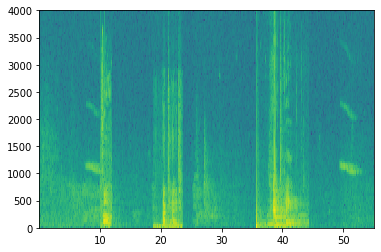

In [9]:
data, spectrum, freqs, t, im = spectrogram(file)

In [10]:
print("total number of sampling data points in the orginal data: " + str(data.shape[0]))
# the number of timesteps of the spectrogram will be about (total number of data points)/(NFFT-noverlap)
print("\nnumber of time steps in the spectrogram: " + str(t.shape[0])) 
# note the maximum time is (total number of data points)/Fs
print("\nsequence of time steps in the spectrogram:")
print(str(t))
# there are totally NFFT frequencies, and half of them are useful.
print("\nnumber of frequencies in the spectrogram: " + str(freqs.shape[0]))
# the frequencies are 0, Fs/NFFT, Fs/NFFR*2, ..., 1/2*Fs
print("\nsequence of frequencies in the spectrogram:")
print(str(freqs))

total number of sampling data points in the orginal data: 441000

number of time steps in the spectrogram: 5511

sequence of time steps in the spectrogram:
[1.25000e-02 2.25000e-02 3.25000e-02 ... 5.50925e+01 5.51025e+01
 5.51125e+01]

number of frequencies in the spectrogram: 101

sequence of frequencies in the spectrogram:
[   0.   40.   80.  120.  160.  200.  240.  280.  320.  360.  400.  440.
  480.  520.  560.  600.  640.  680.  720.  760.  800.  840.  880.  920.
  960. 1000. 1040. 1080. 1120. 1160. 1200. 1240. 1280. 1320. 1360. 1400.
 1440. 1480. 1520. 1560. 1600. 1640. 1680. 1720. 1760. 1800. 1840. 1880.
 1920. 1960. 2000. 2040. 2080. 2120. 2160. 2200. 2240. 2280. 2320. 2360.
 2400. 2440. 2480. 2520. 2560. 2600. 2640. 2680. 2720. 2760. 2800. 2840.
 2880. 2920. 2960. 3000. 3040. 3080. 3120. 3160. 3200. 3240. 3280. 3320.
 3360. 3400. 3440. 3480. 3520. 3560. 3600. 3640. 3680. 3720. 3760. 3800.
 3840. 3880. 3920. 3960. 4000.]


The graph below represents how active each frequency is (y axis) over a number of time-steps (x axis). 

<img src="images/spectrogram.png" style="width:500px;height:200px;">

Spectrogram of an audio recording, where the color shows the degree to which different frequencies are present (loud) in the audio at different points in time. Green squares means a certain frequency is more active or more present in the audio clip (louder); blue squares denote less active frequencies.

The dimension of the output spectrogram depends upon the hyperparameters of the spectrogram software and the length of the input. In this notebook, we will be working with 10 second audio clips as the "standard length" for our training examples. The number of timesteps of the spectrogram will be 5511. The spectrogram will be the input $x$ into the network, and so $T_x = 5511$.

In [11]:
print('time steps of audio before spectrogram: ' + str(data.shape))
print('time steps of audio after spectrogram: '  + str(t.shape))
print('dimension of spectrogram: ' + str(spectrum.shape) )

time steps of audio before spectrogram: (441000,)
time steps of audio after spectrogram: (5511,)
dimension of spectrogram: (101, 5511)


Note that even with 10 seconds being our default training example length, 10 seconds of time can be discretized to different numbers of value. We've seen 441000 (raw audio) and 5511 (spectrogram). In the former case, each step represents $10/441000 \approx 0.000023$ seconds. In the second case, each step represents $10/5511 \approx 0.0018$ seconds. 

For the 10sec of audio, the key values we will use are:

- $441000$ (raw audio)
- $5511 = T_x$ (spectrogram output, and dimension of input to the neural network). 
- $10000$ (used by the `pydub` module to synthesize audio) 
- $1375 = T_y$ (the number of steps in the output of the GRU we'll build). 

Note that each of these representations correspond to exactly 10 seconds of time. It's just that they are discretized to different degrees. All of these are hyperparameters and can be changed (except the 441000, which is a function of the microphone). We have chosen values that are within the standard ranges used for speech systems. 

Consider the $T_y = 1375$ number above. This means that for the output of the model, we discretize the 10s into 1375 time-intervals (each one of length $10/1375 \approx 0.0072$s) and try to predict for each of these intervals whether someone recently finished saying "activate." 

Consider also the 10000 number above. This corresponds to discretizing the 10sec clip into 10/10000 = 0.001 second itervals, or 1ms.

### 1.3 Training Dataset Generation

Because speech data is hard to acquire and label, we will synthesize our training data using the audio clips of activates, negatives, and backgrounds. It is quite slow to record lots of 10 second audio clips with random "activates" in it. Instead, it is easier to record lots of positives and negative words, and record background noise separately (or download background noise from free online sources). 

To synthesize a single training example, we will:

- Pick a random 10 second background audio clip
- Randomly insert 0-4 audio clips of "activate" into this 10sec clip
- Randomly insert 0-2 audio clips of negative words into this 10sec clip

Because we had synthesized the word "activate" into the background clip, we know exactly when in the 10sec clip the "activate" makes its appearance. This makes it easier to generate the labels $y^{\langle t \rangle}$ as well. 

We will use the pydub package to manipulate audio. Pydub converts raw audio files into lists of Pydub data structures. Pydub uses 1ms as the discretization interval (1ms is 1 millisecond = 1/1000 seconds) which is why a 10sec clip is always represented using 10,000 steps. 

In [12]:
def load_raw_audio():
    """
    load audio segments using pydub
    """
    activates = []
    negatives = []
    backgrounds = []
    
    for filename in os.listdir(path = 'data/audio_raw_data/activates'):
        if filename.endswith('.wav'):
            cur = AudioSegment.from_wav('data/audio_raw_data/activates/' + filename) # Open a WAV file
            activates.append(cur)
    for filename in os.listdir(path = 'data/audio_raw_data/negatives'):
        if filename.endswith('.wav'):
            cur = AudioSegment.from_wav('data/audio_raw_data/negatives/' + filename)
            negatives.append(cur)
    for filename in os.listdir(path = 'data/audio_raw_data/backgrounds'):
        if filename.endswith('.wav'):
            cur = AudioSegment.from_wav('data/audio_raw_data/backgrounds/' + filename)
            backgrounds.append(cur)
            
    return activates, negatives, backgrounds

In [13]:
activates, negatives, backgrounds = load_raw_audio()

print('background[0] length (ms): ' + str(len(backgrounds[0]))) # should be 10000, since it is 10 sec = 10000 ms clip
print('activates[0] length (ms): ' + str(len(activates[0])))
print('negatives[0] length (ms): ' + str(len(negatives[0]))) 

background[0] length (ms): 10000
activates[0] length (ms): 721
negatives[0] length (ms): 360


**Overlaying positive/negative words on the background**:

Given a 10sec background clip and a short audio clip (positive or negative word), we need to be able to "add" or "insert" the word's short audio clip onto the background. To ensure audio segments inserted onto the background do not overlap, we will keep track of the times of previously inserted audio clips. We will be inserting multiple clips of positive/negative words onto the background, and we don't want to insert an "activate" or a random word somewhere that overlaps with another clip we had previously added. 

For clarity, when we insert a 1sec "activate" onto a 10sec clip of cafe noise, we end up with a 10sec clip that sounds like someone saying "activate" in a cafe, with "activate" superimposed on the background cafe noise. We do *not* end up with an 11 sec clip. 

**Creating the labels at the same time we overlay**:

Recall also that the labels $y^{\langle t \rangle}$ represent whether or not someone has just finished saying "activate." Given a background clip, we can initialize $y^{\langle t \rangle}=0$ for all $t$, since the clip doesn't contain any "activates." 

When we insert or overlay an "activate" clip, we will also update labels for $y^{\langle t \rangle}$, so that 50 steps of the output now have target label 1. We will train a GRU to detect when someone has *finished* saying "activate". For example, suppose the synthesized "activate" clip ends at the 5sec mark in the 10sec audio---exactly halfway into the clip. Recall that $T_y = 1375$, so timestep $687 = $ `int(1375*0.5)` corresponds to the moment at 5sec into the audio. So, we will set $y^{\langle 688 \rangle} = 1$. Further, we would be quite satisfied if the GRU detects "activate" anywhere within a short time-internal after this moment, so we actually set 50 consecutive values of the label $y^{\langle t \rangle}$ to 1. Specifically, we have $y^{\langle 688 \rangle} = y^{\langle 689 \rangle} = \cdots = y^{\langle 737 \rangle} = 1$.  

This is another reason for synthesizing the training data: it's relatively straightforward to generate these labels $y^{\langle t \rangle}$ as described above. In contrast, if we have 10sec of audio recorded on a microphone, it's quite time consuming for a person to listen to it and mark manually exactly when "activate" finished. 

Here's a figure illustrating the labels $y^{\langle t \rangle}$, for a clip which we have inserted "activate", "innocent", "activate", "baby." Note that the positive labels "1" are associated only with the positive words. 

<img src="images/label_diagram.png" style="width:500px;height:200px;">

To implement the training set synthesis process, we will use the following helper functions. All of these function will use a 1ms discretization interval, so the 10sec of audio is alwsys discretized into 10,000 steps. 

1. `get_random_time_segment(segment_ms)` gets a random time segment in our background audio
2. `is_overlapping(segment_time, existing_segments)` checks if a time segment overlaps with existing segments
3. `insert_audio_clip(background, audio_clip, existing_times)` inserts an audio segment at a random time in our background audio using `get_random_time_segment` and `is_overlapping`
4. `insert_ones(y, segment_end_ms)` inserts 1's into our label vector y after the word "activate"

In [14]:
# gets a random time segment in our background audio

def get_random_time_segment(segment_ms, audio_ms):
    """
    Gets a random time segment of duration segment_ms, in an audio clip of duration audio_ms
    
    Arguments:
    segment_ms: duration of the random segment in ms.
    audio_ms: duration of the entire audio clip.
    
    Returns:
    a tuple of (segment_start, segment_end) in ms
    """
    
    # Return random integers from low (inclusive) to high (exclusive).
    segment_start = np.random.randint(low = 0, high = audio_ms - segment_ms + 1)
    segment_end = segment_start + segment_ms - 1
    
    return (segment_start, segment_end)

Next, suppose we have inserted audio clips at segments (1000,1800) and (3400,4500). I.e., the first segment starts at step 1000, and ends at step 1800. Now, if we are considering inserting a new audio clip at (3000,3600), since (3000,3600) and (3400,4500) overlap, we should decide against inserting a clip here. 

For the purpose of this function, define (100,200) and (200,250) to be overlapping, since they overlap at timestep 200. However, (100,199) and (200,250) are non-overlapping. 

In [15]:
# checks if a time segment overlaps with existing segments

def is_overlapping(segment, existing_segments):
    """
    check if a new time segment overlaps with any of the previous segments.
    
    Arguments:
    segment: a tuple of (segment_start, segment_end) in ms for the new segment
    existing_segments: a list of tuples of (segment_start, segment_end) for previous segments
    
    Returns:
    True if the new segment overlaps with any of the previous segments, False otherwise
    """
    
    segment_start, segment_end = segment
    for cur_start, cur_end in existing_segments:
        if segment_start <= cur_end and segment_end >= cur_start:
            return True
        
    return False

Now, let's use the previous helper functions to insert a new audio clip onto the 10sec background at a random time, but making sure that any newly inserted segment doesn't overlap with the previous segments. 

We will need to carry out 4 steps:

1. Get a random time segment of the right duration in ms.
2. Make sure that the time segment does not overlap with any of the previous time segments. If it is overlapping, then go back to step 1 and pick a new time segment.
3. Add the new time segment to the list of existing time segments, so as to keep track of all the segments we've inserted.  
4. Overlay the audio clip over the background using pydub.

In [16]:
# inserts an audio segment at a random time in our background audio

def insert_audio_clip(background, insert_clip, existing_segments):
    """
    overlay an audio clip onto the background clip. 
    
    Arguments:
    background: the background audio clip
    insert_clip: the audio clip to be inserted/overlaid
    existing_segments: a list of tuples of (segment_start, segment_end) for inserted segments
    
    Returns:
    new updated background audio clip
    the overlaid segment in ms, tuple of (segment_start, segment_end)
    """
    
    audio_ms = len(background)
    segment_ms = len(insert_clip)
    
    # Get a random time segment of the right duration in ms.
    segment = get_random_time_segment(segment_ms, audio_ms)
    
    # Make sure that the time segment does not overlap with any of the previous time segments. 
    # If it is overlapping, then go back to step 1 and pick a new time segment.
    while is_overlapping(segment, existing_segments):
        segment = get_random_time_segment(segment_ms, audio_ms)
    
    # Add the new time segment to the list of existing time segments, so as to keep track of all 
    # the segments we've inserted.
    existing_segments.append(segment)
    
    # Overlay the audio clip over the background using pydub.
    new_background = background.overlay(insert_clip, position = segment[0])
    
    return new_background, segment

Finally, update the labels $y^{\langle t \rangle}$, assuming we just inserted an "activate." In the code below, `y` is a `(1, Ty)` dimensional vector. 

If the "activate" ended at time step $t$, then set $y^{\langle t+1 \rangle} = 1$ as well as for up to 49 additional consecutive values. However, make sure we don't run off the end of the array and try to update `y[0][Ty]`, since the valid indices are `y[0][0]` through `y[0][Ty-1]`.

If a segment ends at `segment_end_ms` (using a 10000 step discretization), to convert it to the indexing for the outputs $y$ (using a $Ty$ step discretization), we will use this formula:  
```
    segment_end_y / Ty = segment_end_ms / 10000.0
    segment_end_y = int(segment_end_ms * Ty / 10000.0)
```

In [17]:
# inserts '1's into our label vector y after the word "activate"

def insert_ones(y, segment_end_ms):
    """
    Update the label vector y. The 50 output steps following the end of segment should be set to 1.
    
    Arguments:
    y: numpy array of shape (1, Ty), the label vector
    segment_end_ms: the end time of the segment in ms
    
    Returns:
    updated labels
    """
    
    segment_end_y = int(segment_end_ms * Ty / 10000.0)
    
    for t in range(segment_end_y + 1, min(Ty + 1, segment_end_y + 51)):
        y[0][t] = 1
    
    return y

Finally, we can use `insert_audio_clip` and `insert_ones` to create a new training example.

We will need to carry out the following steps:

1. Initialize the label vector $y$ as a numpy array of zeros and shape $(1, Ty)$.
2. Initialize the set of existing segments to an empty list.
3. Randomly select 0 to 4 "activate" audio clips, and insert them onto the background. Also insert labels at the correct position in the label vector $y$.
4. Randomly select 0 to 2 negative audio clips, and insert them into the background. 

In [18]:
def create_training_example(background, activates, negatives, seed = 0):
    """
    Create a training example with some 0 to 4 "activates" and 0 to 2 "negatives" inserted onto background
    
    Arguments:
    background: the background audio segment
    activates: a list of "activate" audio segments
    negatives: a list of "negative" audio segments
    seed: random seed
    
    Returns:
    x: the spectrogram of the synthesized example
    y: the labels
    """
    
    np.random.seed(seed)
    
    # make background quieter
    background = background - 20
    
    # Initialize the label vector y as a numpy array of zeros and shape  (1,Ty)
    y = np.zeros((1, Ty))
    
    # Initialize the set of existing segments to an empty list
    existing_segments = []
    
    # Randomly select 0 to 4 "activate" audio clips
    number_activates = np.random.randint(0, 5)
    activate_indices = np.random.randint(len(activates), size = number_activates)
    random_activates = [activates[i] for i in activate_indices]
    
    # insert selected activates onto the background. Also insert labels at the correct position in the label vector y
    for random_activate in random_activates:
        background, segment = insert_audio_clip(background, random_activate, existing_segments)
        y = insert_ones(y, segment[1])
        
    # Randomly select 0 to 2 "negative" audio clips
    number_negatives = np.random.randint(0, 3)
    negative_indices = np.random.randint(len(negatives), size = number_negatives)
    random_negatives = [negatives[i] for i in negative_indices]
    
    # insert selected negatives onto the background
    for random_negative in random_negatives:
        background, _ = insert_audio_clip(background, random_negative, existing_segments)
    
    # Standardize the volumn of the audio clip
    target = -20.0
    # dBFS: db relative to the maximum possible loudness 
    gain = target - background.dBFS
    background = background.apply_gain(gain)
    
    # export the new training example
    fname = 'data/audio_raw_data/audio_synthesized.wav'
    background.export(fname, format = 'wav')
    
    # get and plot the spectrogram of the new background with activates and negatives overlaid
    _, x, _, _, _ = spectrogram(fname)
    
    return x, y

shape of x: (101, 5511)
shape of y: (1, 1375)


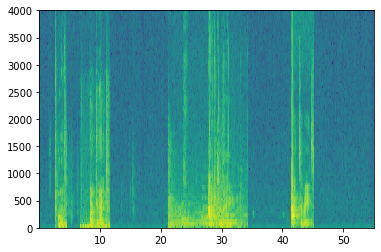

In [19]:
x, y = create_training_example(backgrounds[0], activates, negatives, 14)
print("shape of x: " + str(x.shape))
print("shape of y: " + str(y.shape))

In [20]:
# play the synthesized audio data
IPython.display.Audio('data/audio_raw_data/audio_synthesized.wav')

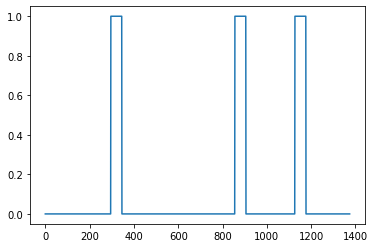

In [21]:
# plot the label y

figure = plt.plot(y[0])

### 1.4 Load Training and Development Dataset

To test our model, we recorded a development set of 25 examples. While our training data is synthesized, we want to create a development set using the same distribution as the real inputs. Thus, we recorded 25 10-second audio clips of people saying "activate" and other random words, and labeled them by hand. This follows the principle that we should create the dev set to be as similar as possible to the test set distribution; that's why our dev set uses real rather than synthesized audio. 

**Note that on GitHub, X.npy and X_dev.npy are compressed to .rar files. Need to firstly unrar them.**

In [22]:
# Load arrays or pickled objects from .npy, .npz or pickled files.
x_train = np.load('data/data_train/X.npy')
y_train = np.load('data/data_train/Y.npy')
x_dev = np.load('data/data_train/X_dev.npy')
y_dev = np.load('data/data_train/Y_dev.npy')

In [23]:
print("shape of x_train: " + str(x_train.shape))
print("shape of y_train: " + str(y_train.shape))
print("shape of x_dev: " + str(x_dev.shape))
print("shape of y_dev: " + str(y_dev.shape))

shape of x_train: (26, 5511, 101)
shape of y_train: (26, 1375, 1)
shape of x_dev: (25, 5511, 101)
shape of y_dev: (25, 1375, 1)


## 2. Build Model

Let's build a trigger word detection model. 

The model will use 1-D convolutional layers, GRU layers, and dense layers. 

### 2.1 Model Architecture

Here is the architecture we will use.

<img src="images/model_trigger_word.png" style="width:600px;height:600px;">

One key step of this model is the 1D convolutional step. It inputs the 5511 step spectrogram, and outputs a 1375 step output, which is then further processed by multiple layers to get the final $Ty = 1375$ step output. This layer plays a role similar to the 2D convolutions, of extracting low-level features and then possibly generating an output of a smaller dimension.

Computationally, the 1-D conv layer also helps speed up the model because now the GRU  has to process only 1375 timesteps rather than 5511 timesteps. The two GRU layers read the sequence of inputs from left to right, then ultimately uses a dense+sigmoid layer to make a prediction for $y^{\langle t \rangle}$. Because $y$ is binary valued (0 or 1), we use a sigmoid output at the last layer to estimate the chance of the output being 1, corresponding to the user having just said "activate."

Note that we use a uni-directional RNN rather than a bi-directional RNN. This is really important for trigger word detection, since we want to be able to detect the trigger word almost immediately after it is said. If we used a bi-directional RNN, we would have to wait for the whole 10sec of audio to be recorded before we could tell if "activate" was said in the first second of the audio clip.

Implementing the model can be done in four steps:
    
**Step 1**: CONV layer. Use `Conv1D()` to implement this, with 196 filters, 
a filter size of 15 (`kernel_size=15`), and stride of 4. [[See documentation.](https://keras.io/layers/convolutional/#conv1d)]

**Step 2**: First GRU layer. To generate the GRU layer, use:
```
X = GRU(units = 128, return_sequences = True)(X)
```
Setting `return_sequences=True` ensures that all the GRU's hidden states are fed to the next layer. Remember to follow this with Dropout and BatchNorm layers. 

**Step 3**: Second GRU layer. This is similar to the previous GRU layer (remember to use `return_sequences=True`), but has an extra dropout layer. 

**Step 4**: Create a time-distributed dense layer as follows: 
```
X = TimeDistributed(Dense(1, activation = "sigmoid"))(X)
```
This creates a dense layer followed by a sigmoid, so that the parameters used for the dense layer are the same for every time step. [[See documentation](https://keras.io/layers/wrappers/).]

In [24]:
def model(input_shape):
    """
    Implement the trigger word detection model.
    
    Arguments:
    input_shape: shape of the model's input data excluding the batch size, (steps, channels), where each channel 
    is a frequency
    
    Returns:
    Keras model instance
    """
    
    X_input = Input(shape = input_shape)
    
    
       
    # Input: (batch, steps, channels). Output: (batch, new_steps, filters)    
    X = Conv1D(filters = 196, kernel_size = 15, strides = 4)(X_input) 
    X = BatchNormalization(axis = 2)(X) # along the channel axis
    X = Activation('relu')(X)
    X = Dropout(rate = 0.8)(X)
    
    # Input: (batch_size, timesteps, input_dim). Output if return_sequences: (batch_size, timesteps, units).
    X = GRU(units = 128, return_sequences = True)(X)
    X = Dropout(rate = 0.8)(X)
    X = BatchNormalization(axis = 2)(X) # each GRU unit has the same parameters
    
    X = GRU(units = 128, return_sequences = True)(X)
    X = Dropout(rate = 0.8)(X)
    X = BatchNormalization(axis = 2)(X)
    X = Dropout(rate = 0.8)(X)
    
    
    # The input should be at least 3D, and the dimension of index one will be considered to be the temporal dimension.
    # Consider a batch of 32 samples, where each sample is a sequence of 10 vectors of 16 dimensions. 
    # The batch input shape of the layer is then (32, 10, 16), 
    # model.add(TimeDistributed(Dense(8), input_shape=(10, 16)))
    # The output will then have shape (32, 10, 8).
    X = TimeDistributed(Dense(1, activation = 'sigmoid'))(X) # the dense layer params are the same for every time step
            
    model = Model(inputs = X_input, outputs = X)
    
    return model

In [25]:
model = model(input_shape = (Tx, n_freq))

In [26]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 5511, 101)         0         
_________________________________________________________________
conv1d_1 (Conv1D)            (None, 1375, 196)         297136    
_________________________________________________________________
batch_normalization_1 (Batch (None, 1375, 196)         784       
_________________________________________________________________
activation_1 (Activation)    (None, 1375, 196)         0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 1375, 196)         0         
_________________________________________________________________
gru_1 (GRU)                  (None, 1375, 128)         124800    
_________________________________________________________________
dropout_2 (Dropout)          (None, 1375, 128)         0         
__________

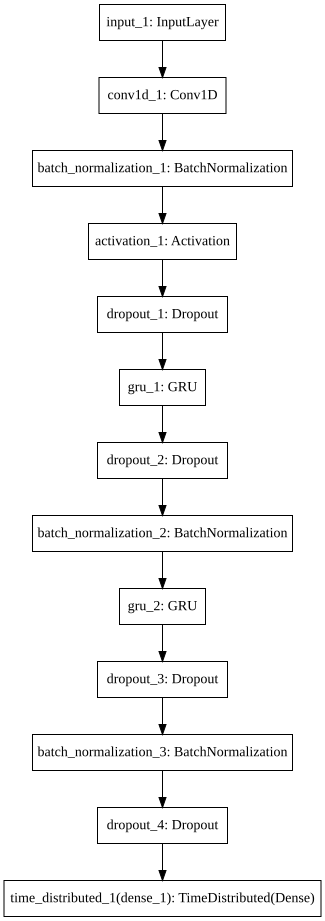

In [27]:
# plot the model schematics
SVG(model_to_dot(model).create(prog='dot', format='svg'))

### 2.2 Model Training

Trigger word detection takes a long time to train. To save time, we've already trained a model for about 3 hours on a GPU using the architecture we built above, and a large training set of about 4000 examples.

We can train the model further, using the Adam optimizer and binary cross entropy loss, as follows. This will run quickly because we are training just for one epoch and with a small training set of 26 examples. 

In [28]:
# load the pre-trained model
trained_model = load_model('pretrained_model/tr_model.h5')

D:\Python\Anaconda3\envs\py3\lib\site-packages\keras\engine\saving.py:327: UserWarning: Error in loading the saved optimizer state. As a result, your model is starting with a freshly initialized optimizer.
  warnings.warn('Error in loading the saved optimizer '


In [29]:
optimizer = Adam(lr = 0.0001, beta_1 = 0.9, beta_2 = 0.999, decay = 0.01)
trained_model.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])

In [30]:
history = trained_model.fit(x = x_train, y = y_train, batch_size = 5, epochs = 1)

Epoch 1/1
26/26 [==============================] - 34s 1s/step - loss: 0.0678 - acc: 0.9751


In [31]:
# the training process above altered the model, so we reload the pre-trained model
trained_model = load_model('pretrained_model/tr_model.h5')

D:\Python\Anaconda3\envs\py3\lib\site-packages\keras\engine\saving.py:327: UserWarning: Error in loading the saved optimizer state. As a result, your model is starting with a freshly initialized optimizer.
  warnings.warn('Error in loading the saved optimizer '


In [32]:
# evaluate the model
preds = trained_model.evaluate(x = x_dev, y = y_dev)
print("Loss: " + str(preds[0]))
print("Accuracy: " + str(preds[1]))

25/25 [==============================] - 4s 152ms/step
Loss: 0.35748031735420227
Accuracy: 0.9502545595169067


This looks pretty good! However, accuracy isn't a great metric for this task, since the labels are heavily skewed to 0's, so a neural network that just outputs 0's would get slightly over 90% accuracy. We could define more useful metrics such as F1 score or Precision/Recall.

## 3. Make Prediction

Once we've estimated the probability of having detected the word "activate" at each output step, we can trigger a "chiming" sound to play when the probability is above a certain threshold. Further, $y^{\langle t \rangle}$ might be near 1 for many values in a row after "activate" is said, yet we want to chime only once. So we will insert a chime sound at most once every 75 output steps. This will help prevent us from inserting two chimes for a single instance of "activate". (This plays a role similar to non-max suppression from computer vision.) 

In [33]:
def make_prediction(model, file):
    """
    The file needs to be a 10-second audio clip
    """
    
    # plot input spectrogram
    plt.subplot(2, 1, 1)
    _, x, _, _, _ = spectrogram(file) 
    # spectrogram() outputs (n_freq, Tx), but we need (batch, Tx, n_freq) for input of the model
    x = np.swapaxes(x, axis1 = 0, axis2 = 1)
    x = np.expand_dims(x, axis = 0)
    output = model.predict(x)
    
    # plot output probabilities
    plt.subplot(2, 1, 2)
    plt.plot(output[0, :, 0]) # the output shape is (batch, Ty, 1)
    plt.ylabel('probability')
    plt.show()
    return output

In [34]:
def make_chime(model, chime_file, audio_file, threshold, export_file):
    """
    insert a chiming sound to the audio when the ouput probability is above threshold
    The audio_file needs to be a 10-second audio clip.
    """
    audio_clip = AudioSegment.from_wav(audio_file) # remember each step is 1ms
    chime_clip = AudioSegment.from_wav(chime_file)
    output = make_prediction(model, audio_file)
    
    audio_len = len(audio_clip)
    
    step = 0
    while step < Ty:
        if output[0, step, 0] > threshold:
            audio_clip = audio_clip.overlay(chime_clip, position = int(step / Ty * audio_len))
            step += 74
        step += 1
    
    audio_clip.export(export_file, format = 'wav')

## 4. Model Testing

In [35]:
# chime sound
chime_file = 'data/audio_chime/chime.wav'
IPython.display.Audio(chime_file)

**Example 1**

In [36]:
file_test = 'data/audio_test/1.wav'
IPython.display.Audio(file_test)

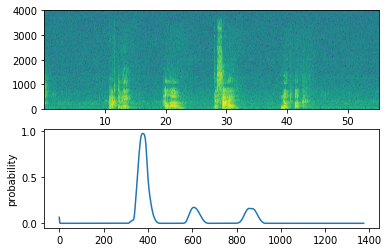

In [37]:
test_export_file = 'data/audio_test/1_chime.wav'
make_chime(trained_model, chime_file = chime_file, audio_file = file_test, threshold = 0.5, 
           export_file = test_export_file)
IPython.display.Audio(test_export_file)

**Example 2**

In [38]:
file_test = 'data/audio_test/2.wav'
IPython.display.Audio(file_test)

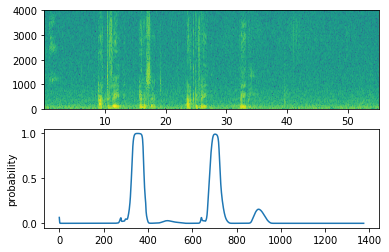

In [39]:
test_export_file = 'data/audio_test/2_chime.wav'
make_chime(trained_model, chime_file = chime_file, audio_file = file_test, threshold = 0.5, 
           export_file = test_export_file)
IPython.display.Audio(test_export_file)

## 5. Test on Our Own Example

Record a 10 second audio clip of saying the word "activate" and other random words. If the audio recording is not 10 seconds, the code below will either trim or pad it as needed to make it 10 seconds. 

In [40]:
def preprocess_audio(file):
    """
    trim or pad the audio to make it 10 seconds
    """
    
    padding = AudioSegment.silent(duration = 10000) # a canvas to overlay other sounds on top of.
    audio = AudioSegment.from_wav(file)[:10000]
    audio = padding.overlay(audio)
    # Creates an equivalent version of this AudioSegment with the specified frame rate (in Hz).    
    audio = audio.set_frame_rate(44100)
    audio.export(file, format = 'wav')

**Example 1**

In [41]:
# synthesize my own example
my_folder = 'data/own_example/'
my_background_file = my_folder + 'raw_data/' + 'bus.wav'
my_activate_file = my_folder + 'raw_data/' + 'activate.wav'
my_negative_file = my_folder + 'raw_data/' + 'negative.wav'

my_background = AudioSegment.from_wav(my_background_file)
my_activate = AudioSegment.from_wav(my_activate_file)
my_negative = AudioSegment.from_wav(my_negative_file)

target = -38.0
gain = target - my_background.dBFS
my_background = my_background.apply_gain(gain)

my_background = my_background.overlay(my_activate, position = 3000)
my_background = my_background.overlay(my_negative, position = 7000)
my_background.export(my_folder + 'results/' + 'synthesized_example1.wav', format = 'wav')

# preprocessing
preprocess_audio(my_folder + 'results/' + 'synthesized_example1.wav')

In [42]:
IPython.display.Audio(my_folder + 'results/' + 'synthesized_example1.wav')

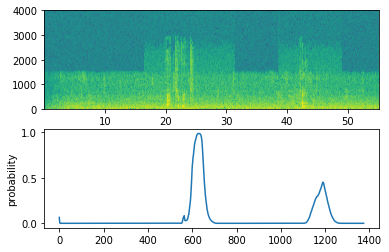

In [43]:
make_chime(trained_model, 
           chime_file = chime_file, 
           audio_file = my_folder + 'results/' + 'synthesized_example1.wav', 
           threshold = 0.5, 
           export_file = my_folder + 'results/' + 'synthesized_example1_chime.wav')
IPython.display.Audio(my_folder + 'results/' + 'synthesized_example1_chime.wav')

**Example 2**

In [44]:
# synthesize my own example
my_folder = 'data/own_example/'
my_background_file = my_folder + 'raw_data/' + 'shampoo_hair.wav'
my_activate_file = my_folder + 'raw_data/' + 'activate.wav'
my_negative_file = my_folder + 'raw_data/' + 'negative.wav'

my_background = AudioSegment.from_wav(my_background_file)
my_background = my_background + my_background
my_activate = AudioSegment.from_wav(my_activate_file)
my_negative = AudioSegment.from_wav(my_negative_file)

target = -50.0
gain = target - my_background.dBFS
my_background = my_background.apply_gain(gain)

my_background = my_background.overlay(my_activate, position = 6600)
my_background = my_background.overlay(my_negative, position = 2300)
my_background.export(my_folder + 'results/' + 'synthesized_example2.wav', format = 'wav')

# preprocessing
preprocess_audio(my_folder + 'results/' + 'synthesized_example2.wav')

In [45]:
IPython.display.Audio(my_folder + 'results/' + 'synthesized_example2.wav')

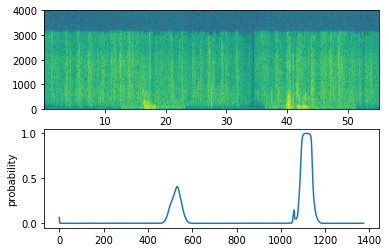

In [46]:
make_chime(trained_model, 
           chime_file = chime_file, 
           audio_file = my_folder + 'results/' + 'synthesized_example2.wav', 
           threshold = 0.5, 
           export_file = my_folder + 'results/' + 'synthesized_example2_chime.wav')
IPython.display.Audio(my_folder + 'results/' + 'synthesized_example2_chime.wav')